# Airline Satisfaction Project

** In this project, I would like to investigate Airline Passenger Satisfaction and what are the key factors that leads to passenger satisfactions. **

https://www.kaggle.com/teejmahal20/airline-passenger-satisfaction?select=test.csv

In [50]:
# Load necessary package 
import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt 
%matplotlib inline 
import seaborn as sns 


In [51]:
# Load the data 
train = pd.read_csv('train.csv')
test = pd.read_csv('test.csv')

In [52]:
# To be able to do some preminary analysis on the dataset, I need to merge the training and testing set first 
satisfaction = train.append(test)

In [53]:
# drop the first unnecessary column 
satisfaction = satisfaction.drop(columns = ['Unnamed: 0'],axis = 1)

In [54]:
satisfaction.head()

,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
0,70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,...,5,4,3,4,4,5,5,25,18.0,neutral or dissatisfied
1,5047,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,...,1,1,5,3,1,4,1,1,6.0,neutral or dissatisfied
2,110028,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,...,5,4,3,4,4,4,5,0,0.0,satisfied
3,24026,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,...,2,2,5,3,1,4,2,11,9.0,neutral or dissatisfied
4,119299,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,...,3,3,4,4,3,3,3,0,0.0,satisfied


In [55]:
# Take a glance at each column and see the data type I am dealing with 
satisfaction.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 129880 entries, 0 to 25975
Data columns (total 24 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   id                                 129880 non-null  int64  
 1   Gender                             129880 non-null  object 
 2   Customer Type                      129880 non-null  object 
 3   Age                                129880 non-null  int64  
 4   Type of Travel                     129880 non-null  object 
 5   Class                              129880 non-null  object 
 6   Flight Distance                    129880 non-null  int64  
 7   Inflight wifi service              129880 non-null  int64  
 8   Departure/Arrival time convenient  129880 non-null  int64  
 9   Ease of Online booking             129880 non-null  int64  
 10  Gate location                      129880 non-null  int64  
 11  Food and drink                     12988

In [56]:
# I decide to use ffill to fill a few missing values in arrival delay in minutes. 
satisfaction = satisfaction.fillna(method = 'ffill')

In [57]:
satisfaction.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 129880 entries, 0 to 25975
Data columns (total 24 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   id                                 129880 non-null  int64  
 1   Gender                             129880 non-null  object 
 2   Customer Type                      129880 non-null  object 
 3   Age                                129880 non-null  int64  
 4   Type of Travel                     129880 non-null  object 
 5   Class                              129880 non-null  object 
 6   Flight Distance                    129880 non-null  int64  
 7   Inflight wifi service              129880 non-null  int64  
 8   Departure/Arrival time convenient  129880 non-null  int64  
 9   Ease of Online booking             129880 non-null  int64  
 10  Gate location                      129880 non-null  int64  
 11  Food and drink                     12988

In [58]:
# Check out the Descriptive Statistics 
satisfaction.describe()

,id,Age,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,Food and drink,Online boarding,Seat comfort,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes
count,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000,129880.000000
mean,64940.500000,39.427957,1190.316392,2.728696,3.057599,2.756876,2.976925,3.204774,3.252633,3.441361,3.358077,3.383023,3.350878,3.632114,3.306267,3.642193,3.286326,14.713713,15.083500
std,37493.270818,15.119360,997.452477,1.329340,1.526741,1.401740,1.278520,1.329933,1.350719,1.319289,1.334049,1.287099,1.316252,1.180025,1.266185,1.176669,1.313682,38.071126,38.439338
min,1.000000,7.000000,31.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,32470.750000,27.000000,414.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,2.000000,3.000000,3.000000,3.000000,2.000000,0.000000,0.000000
50%,64940.500000,40.000000,844.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,4.000000,4.000000,4.000000,4.000000,4.000000,3.000000,4.000000,3.000000,0.000000,0.000000
75%,97410.250000,51.000000,1744.000000,4.000000,4.000000,4.000000,4.000000,4.000000,4.000000,5.000000,4.000000,4.000000,4.000000,5.000000,4.000000,5.000000,4.000000,12.000000,13.000000
max,129880.000000,85.000000,4983.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,1592.000000,1584.000000


# Priminary Analysis 

** I would like to investigate the relationship between Class and passenger satisfaction because when I think of airline satisfaction, the first thing come to my mind is the Class. ** 

Text(0.5, 1.0, 'Passenger Satisfaction base on Class')

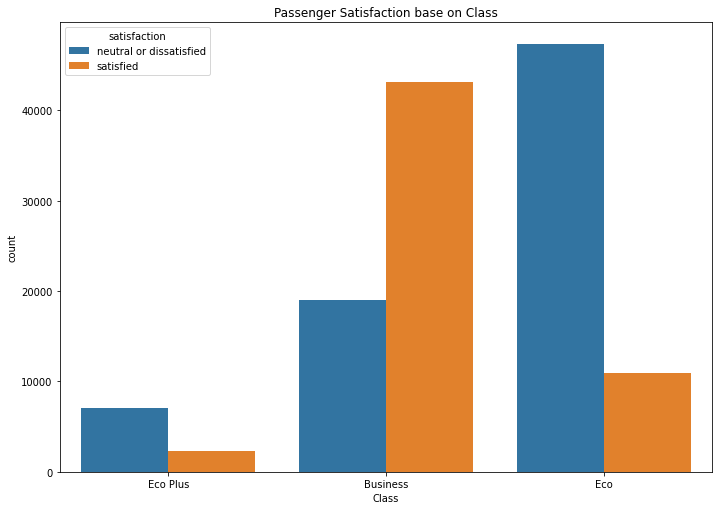

In [59]:
fig, ax = plt.subplots()
fig.set_size_inches(11.7, 8.27)
sns.countplot(data = satisfaction, x = 'Class', hue = 'satisfaction' )
plt.title('Passenger Satisfaction base on Class')

** As we can see from the above chart, most passeger are either economy or business class, and it's really obvious that business class passengers are more satisfied than economy class. And economy plus as a middle class between business and economy, not many people are willing to pay the price because the service doesn't seem to improve much, there are still more people neutral or dissatisfied about the service. **

** The second thing I would like to investigate is the relationship between departure delay and arrival delay and how these two affect the satisfaction. I believe departure delay will usually cause more unsatisfaction,especially Business Travel Passenger **

Text(0.5, 1.0, 'Passenger Satisfaction base on Depature and Arrival Delay')

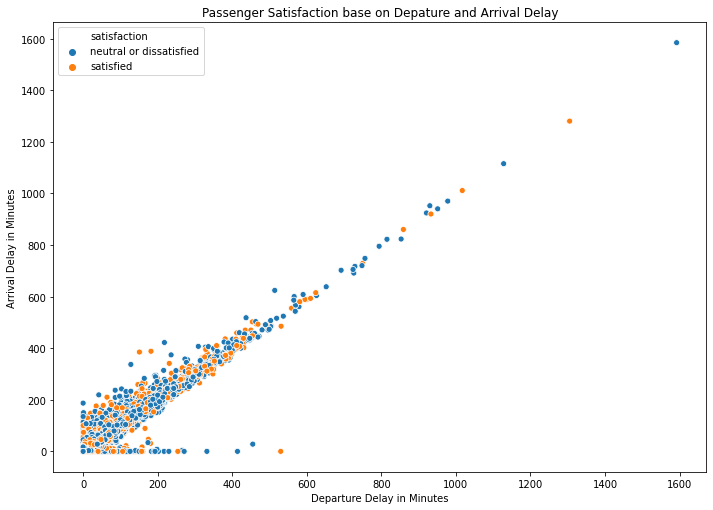

In [60]:
fig, ax = plt.subplots()
fig.set_size_inches(11.7, 8.27)
sns.scatterplot(data = satisfaction, x = 'Departure Delay in Minutes', y = 'Arrival Delay in Minutes', hue = 'satisfaction')
plt.title('Passenger Satisfaction base on Depature and Arrival Delay')

Text(0.5, 1.0, 'Business Passenger Satisfaction base on Depature and Arrival Delay')

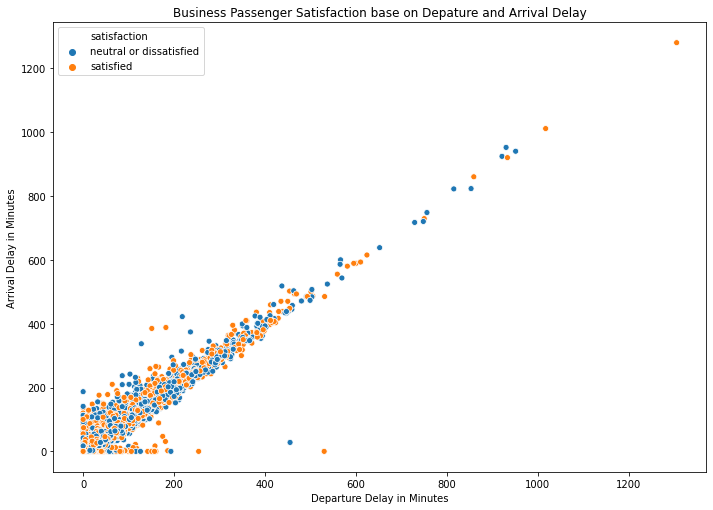

In [61]:
business_satisfaction = satisfaction[satisfaction['Type of Travel'] == 'Business travel']
fig, ax = plt.subplots()
fig.set_size_inches(11.7, 8.27)
sns.scatterplot(data = business_satisfaction, x = 'Departure Delay in Minutes', y = 'Arrival Delay in Minutes', hue = 'satisfaction')
plt.title('Business Passenger Satisfaction base on Depature and Arrival Delay')

** I guess I was wrong. From the above chart, we can see there still a lot of people who are satisfied with the travel even though departure and arrival delayed more than two hours, especially the business travel passenger, one of my guess is that most business travel passenger only fly business class, they don't really care how delay their flight is, as long it's a reasonable amount of delay time. **

** In the last part of this Preminary Analysis, I want to discover how the leg room service and food and drink affect passenger's satisfaction. **

Text(0.5, 1.0, 'Passenger Satisfaction base on Leg room service')

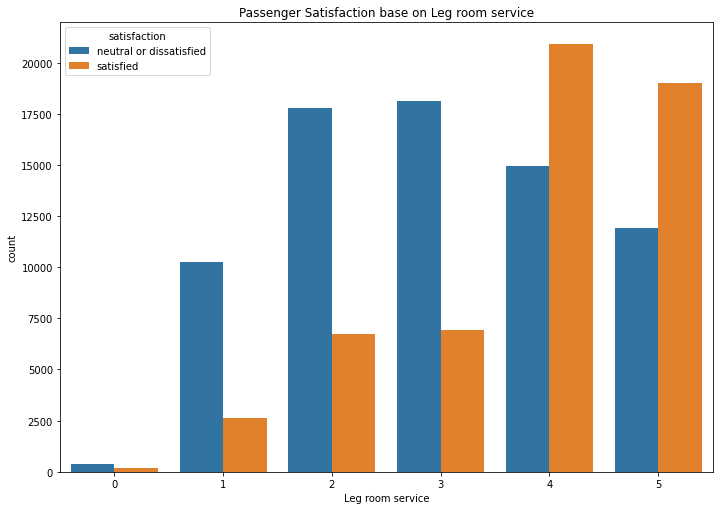

In [62]:
fig, ax = plt.subplots()
fig.set_size_inches(11.7, 8.27)
sns.countplot(data = satisfaction, x = 'Leg room service', hue = 'satisfaction' )
plt.title('Passenger Satisfaction base on Leg room service')

Text(0.5, 1.0, 'Passenger Satisfaction base on food and drink')

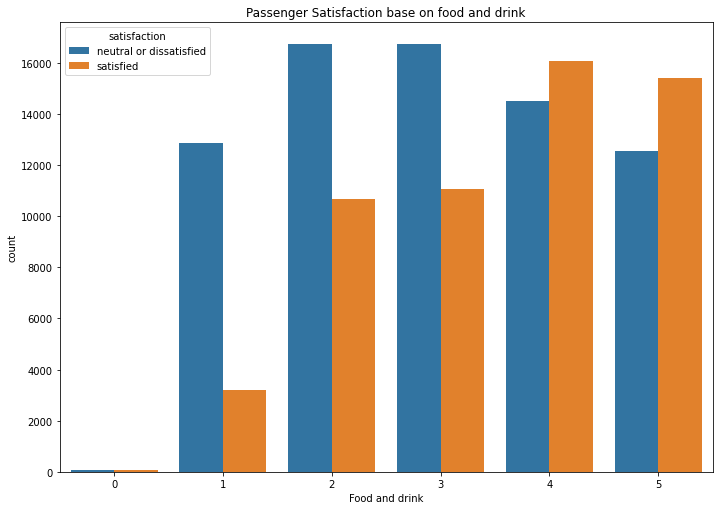

In [63]:
fig, ax = plt.subplots()
fig.set_size_inches(11.7, 8.27)
sns.countplot(data = satisfaction, x = 'Food and drink', hue = 'satisfaction' )
plt.title('Passenger Satisfaction base on food and drink')

** From the chart, I can see both food and drink could have impact on the satisfaction, but not entirely. Therefore, I believe there must be more factors contribute a passenger's satisfaction. **

# Machine Learning 

** According to the above analysis, I believe Class,Food and Drink and Leg Room Service as my features to train my model and predict the satisfaction base only on these features, I would like to see how the results will be. **

In [64]:
satisfaction_class = pd.get_dummies(satisfaction,columns = ['Class'])


In [65]:
X1 = satisfaction_class[['Food and drink','Leg room service','Class_Business','Class_Eco','Class_Eco Plus']]
y1 = satisfaction_class['satisfaction']

In [66]:
from sklearn.model_selection import train_test_split
X_train1, X_test1, y_train1, y_test1 = train_test_split(X1, y1, test_size = 0.2, random_state = 0)


In [67]:
from sklearn.ensemble import RandomForestClassifier
clf = RandomForestClassifier(random_state = 0)

In [90]:
model1 = clf.fit(X_train1, y_train1)

In [69]:
y_pred1 = model1.predict(X_test1)

In [70]:
from sklearn.metrics import classification_report

In [71]:
print(classification_report(y_test1, y_pred1))

precision    recall  f1-score   support

neutral or dissatisfied       0.79      0.87      0.83     14657
              satisfied       0.81      0.70      0.75     11319

               accuracy                           0.79     25976
              macro avg       0.80      0.78      0.79     25976
           weighted avg       0.80      0.79      0.79     25976



** In this second model tryout, I am going to use only food and drink and leg room service as feature and test the satisfaction results.**

In [84]:
X2 = satisfaction[['Food and drink','Leg room service']]
y2 = satisfaction['satisfaction']

In [85]:
X_train2, X_test2, y_train2, y_test2 = train_test_split(X2, y2, test_size = 0.2, random_state = 0)

In [86]:
model2 = clf.fit(X_train2, y_train2)

In [87]:
y_pred2 = model2.predict(X_test2)

In [91]:
print(classification_report(y_test2, y_pred2))

precision    recall  f1-score   support

neutral or dissatisfied       0.73      0.70      0.72     14657
              satisfied       0.64      0.67      0.65     11319

               accuracy                           0.69     25976
              macro avg       0.68      0.69      0.69     25976
           weighted avg       0.69      0.69      0.69     25976



** From the two test above, we can tell that class has a large contribution to the passenger satisfaction. **

** Below I am going to test the passenger satisfaction with Ease of Online booking, On-board service, customer_type. **

In [93]:
satisfaction_customer = pd.get_dummies(satisfaction,columns = ['Customer Type'])

In [96]:
X3 = satisfaction_customer[['Customer Type_Loyal Customer','Customer Type_disloyal Customer','Ease of Online booking','On-board service']]
y3 = satisfaction_customer['satisfaction']

In [98]:
X_train3, X_test3, y_train3, y_test3 = train_test_split(X3, y3, test_size = 0.2, random_state = 0)

In [100]:
model3 = clf.fit(X_train3, y_train3)

In [102]:
y_pred3 = model3.predict(X_test3)

In [104]:
print(classification_report(y_test3, y_pred3))

precision    recall  f1-score   support

neutral or dissatisfied       0.74      0.77      0.76     14657
              satisfied       0.69      0.65      0.67     11319

               accuracy                           0.72     25976
              macro avg       0.72      0.71      0.71     25976
           weighted avg       0.72      0.72      0.72     25976



** I am going to do the test again without customer type. **

In [105]:
X4 = satisfaction[['Ease of Online booking','On-board service']]
y4 = satisfaction['satisfaction']

In [107]:
X_train4, X_test4, y_train4, y_test4 = train_test_split(X4, y4, test_size = 0.2, random_state = 0)

In [109]:
model4 = clf.fit(X_train4, y_train4)

In [110]:
y_pred4 = model4.predict(X_test4)

In [112]:
print(classification_report(y_test4, y_pred4))

precision    recall  f1-score   support

neutral or dissatisfied       0.71      0.77      0.74     14657
              satisfied       0.67      0.59      0.63     11319

               accuracy                           0.69     25976
              macro avg       0.69      0.68      0.68     25976
           weighted avg       0.69      0.69      0.69     25976



** From above two test, we can see that customer type do affect passenger satisfaction, but not by a lot, so I believe it's not deterministic. **